In [54]:
import os
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import warnings
import copy

from networkx.algorithms import community

warnings.simplefilter('ignore')

In [55]:
# identify the communities (by a tool) and plot them

def greedyCommunitiesDetectionByTool(network):
    # Input: a graph
    # Output: list of comunity index (for every node)

    from networkx.algorithms import community

    G = network
    communities_generator = community.girvan_newman(G)
    top_level_communities = next(communities_generator)
    sorted(map(sorted, top_level_communities))
    communities = [0 for node in range(G.number_of_nodes())]
    index = 1
    minim = 1000
    for community in sorted(map(sorted, top_level_communities)):
        minim = min(minim, min(community))
    for community in sorted(map(sorted, top_level_communities)):
        for node in community:
            communities[node - minim] = index
        index += 1
    return communities

In [56]:
"""
    Metoda care citeste un graf dintr-un fisier de tip gml
    @params: filename - path catre un fisier gml
    @return: Graph - un obiect de tip Graph
"""
def readGraph(filename):
    graph = nx.read_gml(filename, label = 'id')

    return graph

In [1]:
"""
    Metoda care afiseaza impartirea in comunitati a algoritmului impreuna cu cea true, daca aceasta este data
    @params: G - reteaua
             predictedCommunities - impartirea in comunitati prezisa
             targetCommunities - adevarata impartirea in comunitati
             node_size - marimea nodurilor din desen 
"""
def plotPredictedTargetNetworkAndFitness(G, fitness, predictedCommunities, fitnesses, generations, targetCommunities = None, node_size = 50):
    np.random.seed(42)

    pos = nx.spring_layout(G) # returneaza un dictionar de forma (nod, pozitie)

    fig, axis = plt.subplots(nrows = 1, ncols = 3, figsize = (20, 10))

    nx.draw_networkx_nodes(G, pos, node_size = node_size, cmap = plt.cm.RdYlBu, node_color = predictedCommunities, ax = axis[0])
    nx.draw_networkx_edges(G, pos, alpha = 0.3, ax = axis[0]) # alpha = edge transparancy
    nx.draw_networkx_labels(G, pos, ax = axis[0]) # alpha = edge transparancy
    axis[0].set_title("Predicted \n number of communities = " + str(len(np.unique(predictedCommunities))) + "\n fitness = " + str(fitness))

    if targetCommunities != None:
        nx.draw_networkx_nodes(G, pos, node_size = node_size, cmap = plt.cm.RdYlBu, node_color = targetCommunities, ax = axis[1])
        nx.draw_networkx_edges(G, pos, alpha = 0.3, ax = axis[1]) # alpha = edge transparancy
        nx.draw_networkx_labels(G, pos, ax = axis[1]) # alpha = edge transparancy
        axis[1].set_title("target")
    
    axis[2].plot(range(1, generations + 1), fitnesses, '-r')

SyntaxError: invalid syntax (3686359235.py, line 8)

In [58]:
"""
    Metoda care returneaza un element ales aleator din lista data
    @params: list - o lista
    @return: un element din lista
"""
def uniformChoiceList(list):
    return np.random.choice(list)

In [59]:
class Chromosome:
    def __init__(self, network = None, representation = None):
        
        self.__representation = []
        if network != None:
            self.__representation = dict([(x, np.random.choice(list(network.neighbors(x)))) for x in network.nodes])
            self.__length = len(self.__representation)
        elif representation != None:
            self.__representation = representation  
            self.__length = len(self.__representation)
  
        self.__fitness = None 
    
    @classmethod
    def decode(cls, representation):
        current_cluster = 1
        clusters = dict([(x, -1) for x in representation])

        for node in representation.keys():
            previous = []
            if clusters[node] == -1:
                clusters[node] = current_cluster
                neighbour = representation[node]
                previous.append(node)

                while clusters[neighbour] == -1:
                    previous.append(neighbour)
                    clusters[neighbour] = current_cluster
                    neighbour = representation[neighbour]

                if clusters[neighbour] != current_cluster:
                    while len(previous):
                        prev = previous.pop()
                        clusters[prev] = clusters[neighbour]
                else:
                    current_cluster += 1
        
        return clusters

    @classmethod
    def communities(cls, representation):
        decoding = Chromosome.decode(representation)
        result = dict()

        for node, cluster in decoding.items():
            if result.get(cluster) == None:
                result[cluster] = [node]
            else:
                result[cluster].append(node)
        
        return result 
    
    @classmethod
    def communityLabels(cls, representation):
        return [x for _, x in Chromosome.decode(representation).items()]

    @property
    def representation(self):
        return self.__representation
    
    @property
    def fitness(self):
        return self.__fitness
    
    @representation.setter
    def representation(self, representation = []):
        self.__representation = representation 
    
    @fitness.setter
    def fitness(self, fitness = None):
        self.__fitness = fitness
    
    """
        Metoda care produce o incrucisare intre doi cromozomi
        @params: chr - un cromozom
        @return: un cromozom reprezentand rezultatul incrucisarii celor dou
    """
    def crossover(self, chr): 
        mask = np.random.randint(0, 2, size = self.__length)
        offspringRepresentation = dict()

        for index, maskValue in zip(self.__representation, mask):
            offspringRepresentation[index]= self.__representation[index] if maskValue else chr.representation[index]

        offspring = Chromosome()        
        offspring.representation = offspringRepresentation
        offspring.__length = len(offspringRepresentation)
        return offspring
    

    """
        Metoda care produce o mutatie la nivelul cromozomului
        @params: network - reteaua pentru care se identifica comunitatile
        @return: -
    """
    def mutation(self, network):
        node = uniformChoiceList(list(self.__representation.keys()))
        neighbours = list(network.neighbors(node))
        #neighbours.remove(self.__representation[node])
        self.__representation[node] = uniformChoiceList(neighbours)

In [60]:
class CommunityFitness:

    def __init__(self, network):
        self._network = network

    def __call__(self, representation):
        raise NotImplementedError()

In [61]:
class ModularityFitness(CommunityFitness):

    def __init__(self, network):
        super().__init__(network)
    

    def __call__(self, representation):
        com = Chromosome.communities(representation)
        q = 0

        for _, nodes in com.items():
            lcc = lcv = 0
            for node in nodes:
                for neighbor in self._network.neighbors(node):
                    if neighbor in nodes:
                        lcc += self._network.number_of_edges(node, neighbor)
                    lcv += self._network.number_of_edges(node, neighbor)
            q += lcc / (2 * self._network.number_of_edges()) - (lcv / (2 * self._network.number_of_edges())) ** 2 
        
        return q

In [62]:
class ModularityDensityFitness(CommunityFitness):

    def __init__(self, network):
        super().__init__(network)

    def __call__(self, representation):
        com = Chromosome.communities(representation)
        d = 0

        for _, nodes in com.items():
            lcc = lcv = 0
            card = len(nodes)
            for node in nodes:
                for neighbor in self._network.neighbors(node):
                    if neighbor in nodes:
                        lcc += self._network.number_of_edges(node, neighbor)
                    else:
                        lcv += self._network.number_of_edges(node, neighbor)
            d += lcc / (card) - (lcv / (card)) 
        
        return d

In [63]:
class CommunityScoreFitness(CommunityFitness):

    def __init__(self, network, alpha = 0.001):
        super().__init__(network)
        self.__alpha = alpha
    
    def __score(self, community):
        card = len(community)
        """
        suma = 0

        for  i in community:
            sumC = 0
            sumM = 0
            for j in community:
                sumC += (self._network.number_of_edges(i, j) / card) ** self.__alpha
                sumM += self._network.number_of_edges(i, j)
            suma += (sumC / card) * sumM

        return suma
        """
        return sum([sum([(self._network.number_of_edges(i, j) / card) ** self.__alpha for j in community]) / card for i in community]) * sum([sum([self._network.number_of_edges(i, j) for j in community]) for i in community])

    def __call__(self, representation):
        com = Chromosome.communities(representation)
        cs = 0

        for _, community in com.items():
            cs += self.__score(community)
        
        return cs

In [64]:
class FitnessCommunityFitness(CommunityFitness):

    def __init__(self, network, alpha = 0.25):
        super().__init__(network)
        self.__alpha = alpha

    def __call__(self, representation):
        com = Chromosome.communities(representation)
        p = 0

        for _, nodes in com.items():
            kin = kout = 0
            for node in nodes:
                for neighbor in self._network.neighbors(node):
                    if neighbor in nodes:
                        kin += self._network.number_of_edges(node, neighbor)
                    else:
                        kout += self._network.number_of_edges(node, neighbor)
            p += kin / ((kin + kout) ** self.__alpha)
        
        return  p / len(com)

In [65]:
class GA:
    def __init__(self, params, problParams):
        self.__params = params
        self.__problParams = problParams
        self.__population = []

        self.__initialization()
        self.__evaluation()
        self.__best = self.__population[0]
    
    def __initialization(self):
        for _ in range(self.__params['popSize']):
            self.__population.append(Chromosome(network = self.__problParams['network']))

    @property
    def population(self):
        return self.__population
    
    def __evaluation(self):
        for chr in self.__population:
            if chr.fitness == None:
                chr.fitness = self.__problParams['fitness'](chr.representation)
        
        self.__probabilities = self.__populationProbabilities(self.__population) 
    
    def bestChromosome(self):
        best = self.__population[0]
        for chr in self.__population:
            if chr.fitness > best.fitness:
                best = chr
        return best

    def worstChromosome(self):
        worst = self.__population[0]
        for chr in self.__population:
            if chr.fitness < worst.fitness:
                worst = chr
        return worst 
    
    def __selection(self):
        """
        best = self.__population[np.random.randint(0, self.__params['popSize'])]
        
        for _ in range(self.__params['k'] - 1):
            position = np.random.randint(0, self.__params['popSize'])
            if best.fitness < self.__population[position].fitness:
                best = self.__population[position] 

        return best
        """

        position1 = np.random.randint(0, self.__params['popSize'])
        position2 = np.random.randint(0, self.__params['popSize'])
        if self.__population[position1].fitness < self.__population[position2].fitness:
            return self.__population[position1]
        return self.__population[position2]
        
        #return np.random.choice(self.__population, size = 1, p = self.__propabilities)[0]

    def __bestNeighbor(self, chromosome):
        communityLabels = Chromosome.communityLabels(chromosome.representation)
        allCommunityLabels = np.unique(communityLabels)

        representation = copy.deepcopy(chromosome.representation)
        bestRepresentation = copy.deepcopy(representation)
        bestFitness = self.__problParams['fitness'](bestRepresentation)

        for node in chromosome.representation:
            originalLabel = representation[node]

            for label in allCommunityLabels:
                representation[node] = label
                localFitness = self.__problParams['fitness'](representation)
                if localFitness > bestFitness:
                    bestFitness = localFitness
                    bestRepresentation = copy.deepcopy(representation)

            representation[node] = originalLabel
        
        result = Chromosome(representation = bestRepresentation)
        result.fitness = self.__problParams['fitness'](representation)

        return result 

    def __sampleChromosomes(self, population, number, probabilities):
        return list(np.random.choice(population, size = number, p = probabilities, replace = False))
    
    def __populationProbabilities(self, population):
        fitnessMin = min(0, min([chr.fitness for chr in population]))
        fitnessSum = sum([chr.fitness + abs(fitnessMin) for chr in population])
        #print([chr.fitness + abs(fitnessMin) for chr in population if chr.fitness < 0])

        return [(chr.fitness + abs(fitnessMin)) / fitnessSum for chr in population]
    
    def __localSearch(self):
            best = self.bestChromosome()
            bestPos = 0

            for pos in range(self.__params['popSize']):
                if self.__population[pos].fitness > best.fitness:
                    bestPos = pos
                    best = self.__population[pos]
            
            self.__population[bestPos] = self.__bestNeighbor(best)


    def __oneRoulleteFractionGenerator(self):
        newPop = self.__sampleChromosomes(self.__population, int(self.__params['pc'] * self.__params['popSize']), self.__probabilities)
        probabilities = self.__populationProbabilities(newPop) 

        crossoverPop = []
        for i in range(self.__params['popSize'] - len(newPop)):
            chrs = self.__sampleChromosomes(newPop, 2, probabilities)
            crossoverPop.append(chrs[0].crossover(chrs[1]))
        newPop.extend(crossoverPop)
        
        for i in range(self.__params['popSize']):
            if np.random.random() <= self.__params['pm']:
                newPop[i].mutation(self.__problParams['network'])
        
        self.__population = newPop
        self.__evaluation()

    def __oneGeneration(self):
        newPop = []
        for _  in range(self.__params['popSize']):
            chr1 = self.__selection()
            chr2 = self.__selection()
            offspring = chr1.crossover(chr2)
            offspring.mutation(self.__problParams['network'])
            newPop.append(offspring)

        self.__population = newPop
        self.__evaluation()

    def __oneGenerationElitism(self):
        newPop = [self.bestChromosome()]
        for _  in range(self.__params['popSize'] - 1):
            chr1 = self.__selection()
            chr2 = self.__selection()
            offspring = chr1.crossover(chr2)
            offspring.mutation(self.__problParams['network'])
            newPop.append(offspring)

        self.__population = newPop
        self.__evaluation()
    
    def __oneGenerationSteadyState(self):
        for _ in range(self.__params['popSize']):
            chr1 = self.__selection()
            chr2 = self.__selection()
            offspring = chr1.crossover(chr2)
            offspring.mutation(self.__problParams['network'])
            offspring.fitness = self.__problParams['fitness'](offspring.representation)
            worst = self.worstChromosome()
            if offspring.fitness < worst.fitness:
                worst = offspring

    def solve(self):
        fitnesses = []
        for _ in range(self.__params['noGen']):
            self.__oneRoulleteFractionGenerator()
            self.__localSearch()

            bestChr = self.bestChromosome()
            
            if self.__best.fitness < bestChr.fitness:
                self.__best = bestChr 

            fitnesses.append(bestChr.fitness)
        
        return [self.bestChromosome(), fitnesses]

In [66]:
networksPaths = [os.path.join(os.getcwd(), 'data', 'dolphins', 'dolphins.gml'), os.path.join(os.getcwd(), 'data', 'karate', 'karate.gml'), 
                 os.path.join(os.getcwd(), 'data', 'football', 'football.gml'), os.path.join(os.getcwd(), 'data', 'krebs', 'krebs.gml'),
                 os.path.join(os.getcwd(), 'data', 'lesmis', 'lesmis.gml'),
                 os.path.join(os.getcwd(), 'data', 'unu', 'unu.gml'), os.path.join(os.getcwd(), 'data', 'doi', 'doi.gml'),
                 os.path.join(os.getcwd(), 'data', 'trei', 'trei.gml'), os.path.join(os.getcwd(), 'data', 'patru', 'patru.gml'),
                 os.path.join(os.getcwd(), 'data', 'cinci', 'cinci.gml'), os.path.join(os.getcwd(), 'data', 'sase', 'sase.gml')]
networks = [readGraph(x) for x in networksPaths]
networksLabelsPaths = [os.path.join(os.getcwd(), 'data', 'dolphins', 'classLabeldolphins.txt'), os.path.join(os.getcwd(), 'data', 'karate', 'classLabelkarate.txt'), 
                 os.path.join(os.getcwd(), 'data', 'football', 'classLabelfootball.txt'), os.path.join(os.getcwd(), 'data', 'krebs', 'classLabelkrebs.txt'),
                 None,
                 os.path.join(os.getcwd(), 'data', 'unu', 'classLabelunu.txt'), os.path.join(os.getcwd(), 'data', 'doi', 'classLabeldoi.txt'),
                 os.path.join(os.getcwd(), 'data', 'trei', 'classLabeltrei.txt'), os.path.join(os.getcwd(), 'data', 'patru', 'classLabelpatru.txt'),
                 os.path.join(os.getcwd(), 'data', 'cinci', 'classLabelcinci.txt'), os.path.join(os.getcwd(), 'data', 'sase', 'classLabelsase.txt')]
networksLabels = [greedyCommunitiesDetectionByTool(network) for network in networks]

In [67]:
gaParams = {'popSize': 50, 'noGen': 200, 'k': 2, 'pc' : 0.2, 'pm': 0.01}

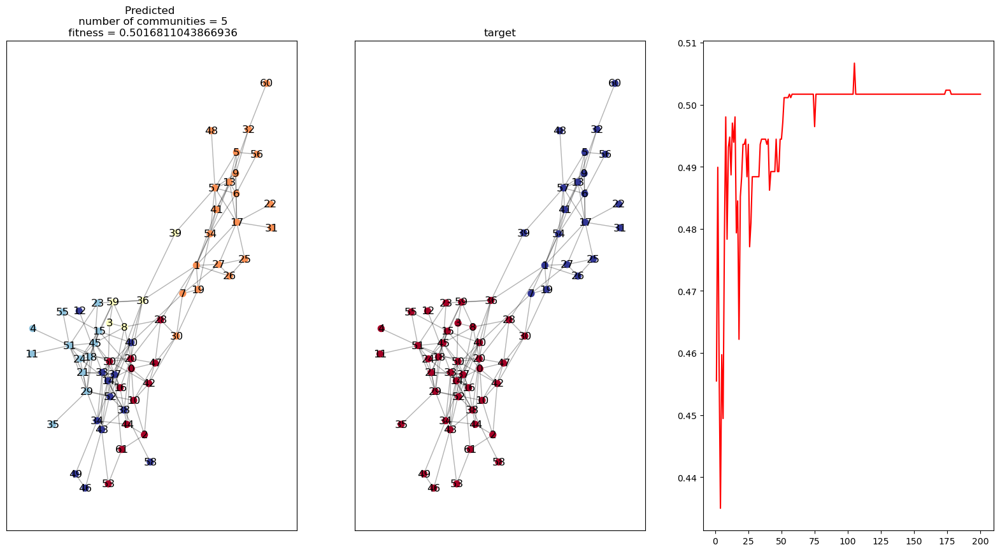

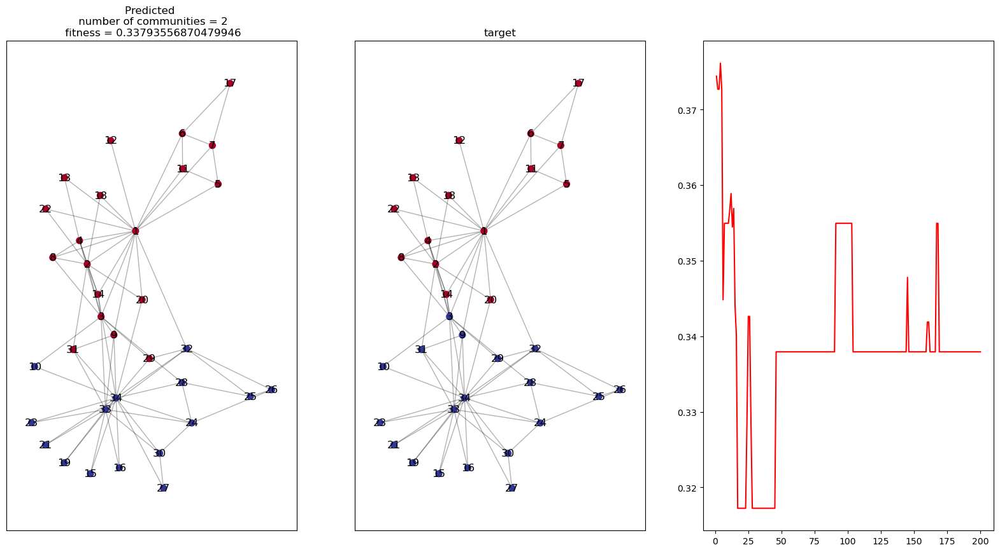

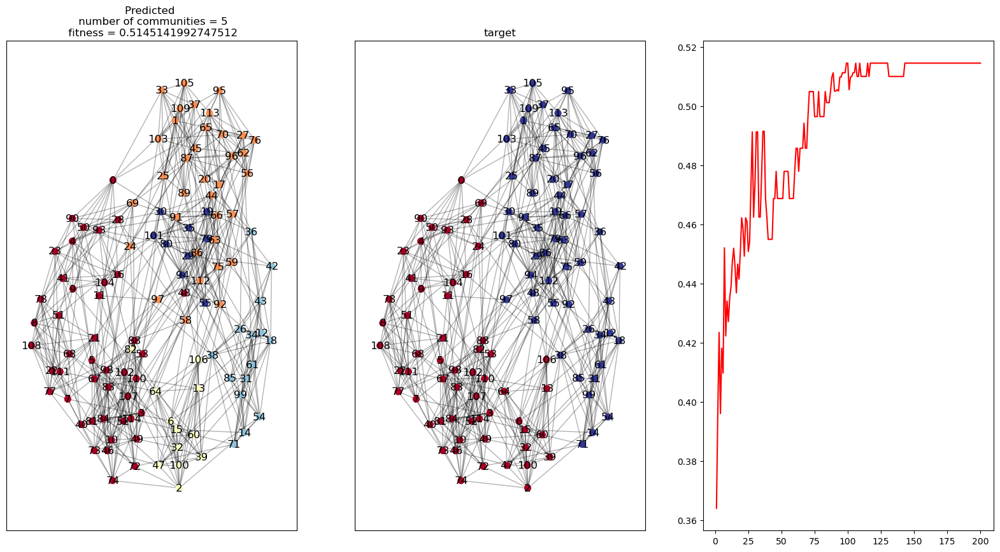

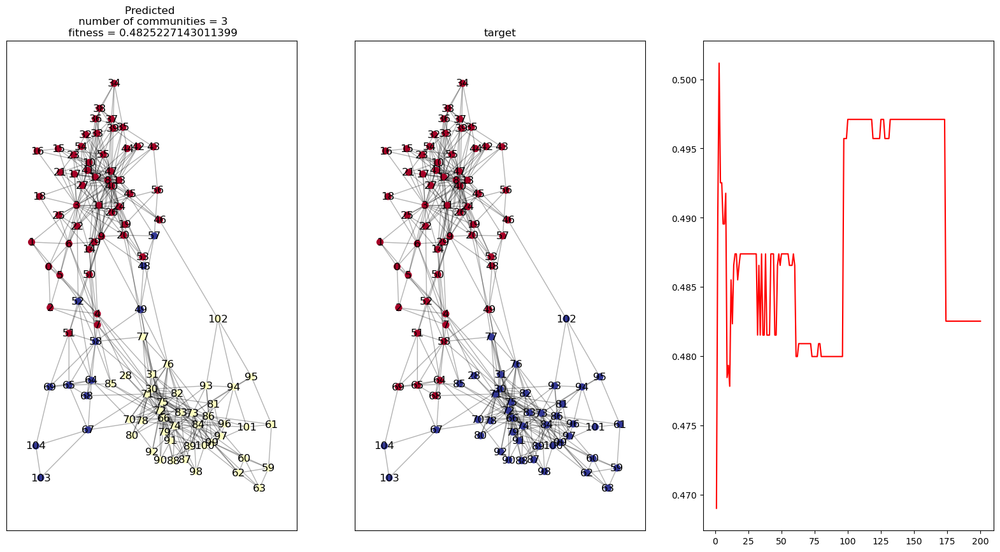

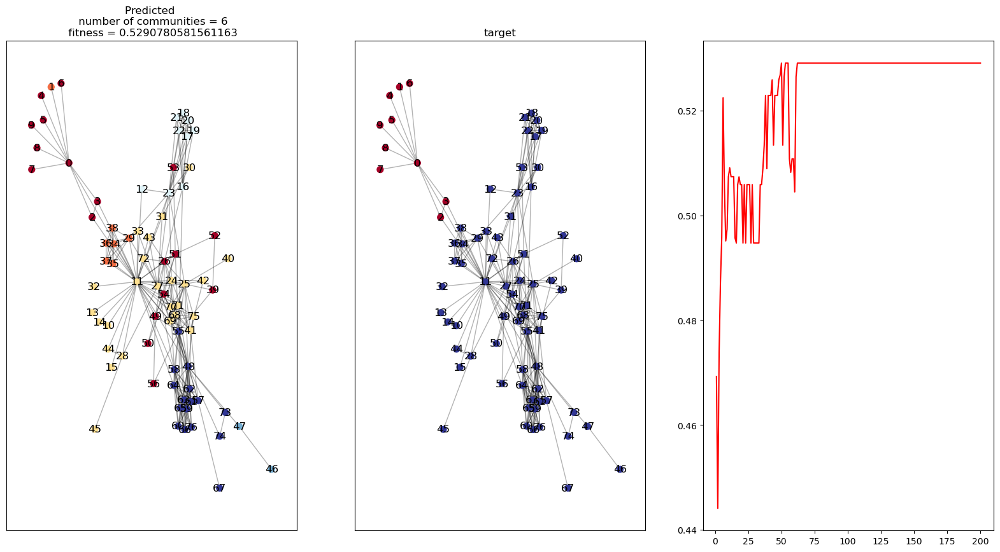

...

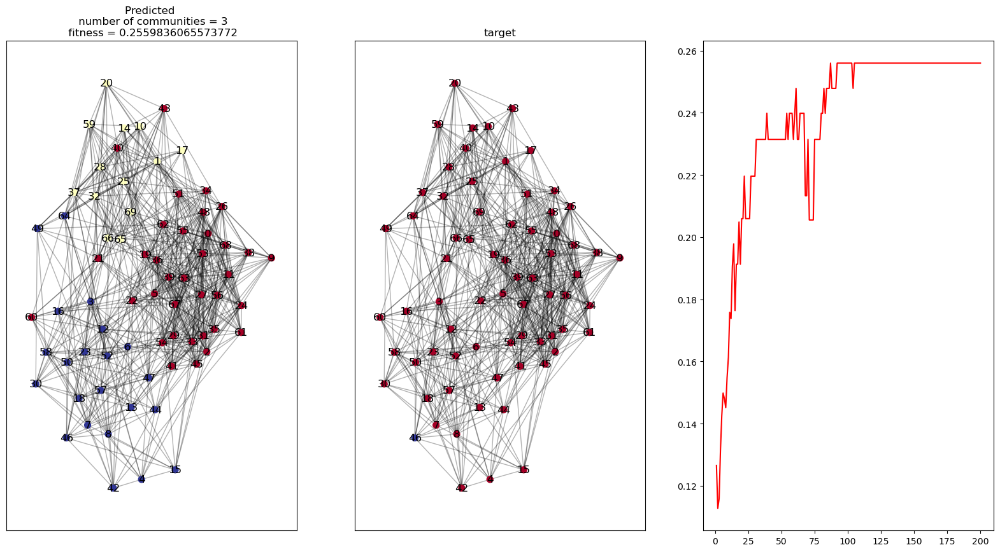

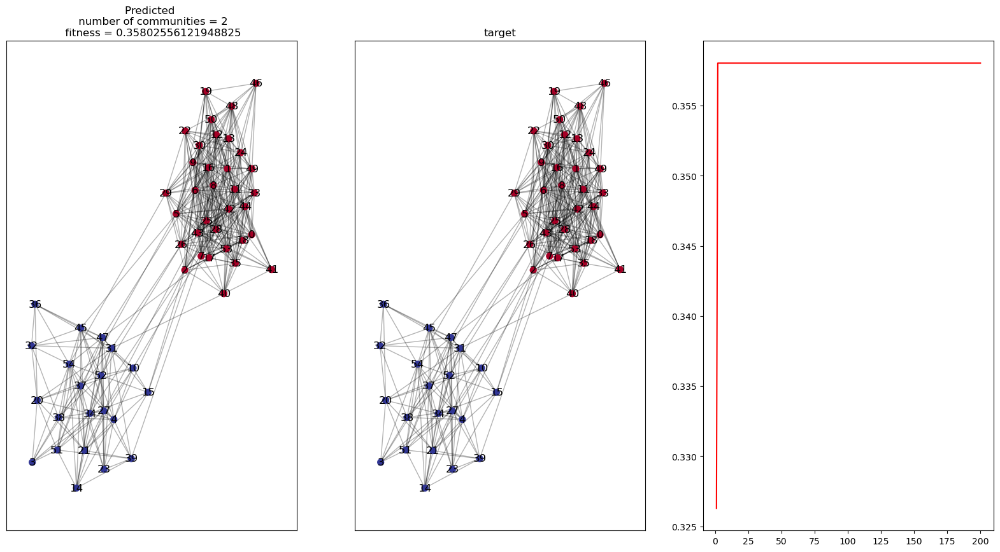

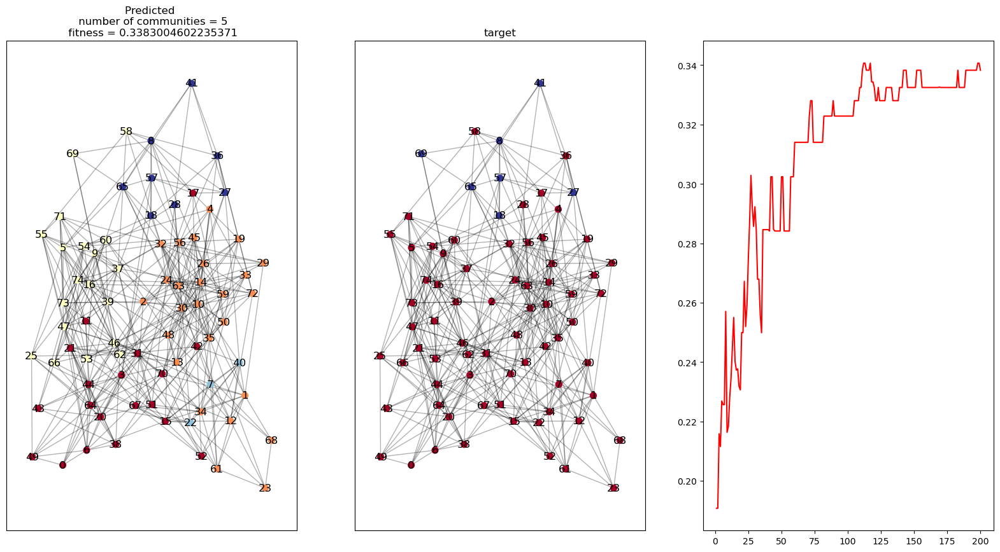

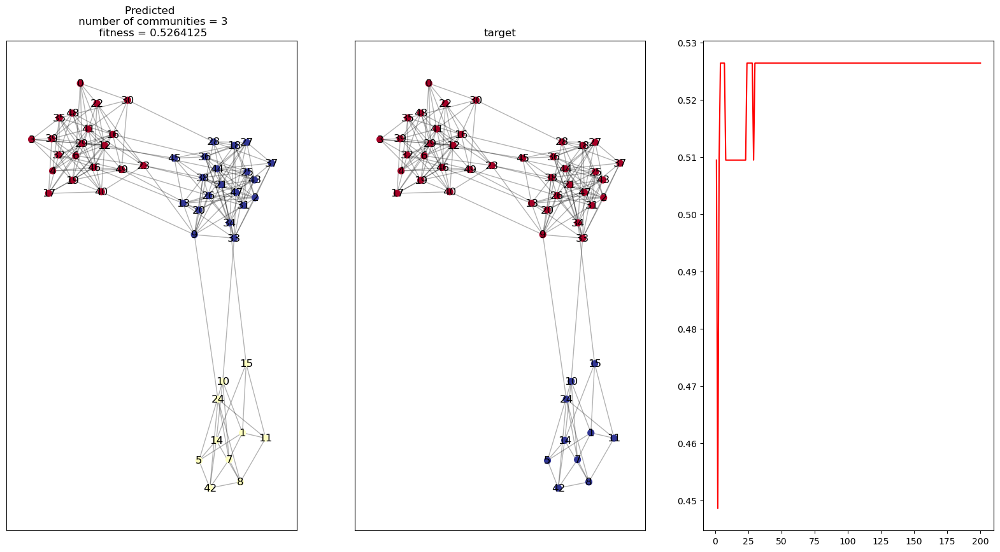

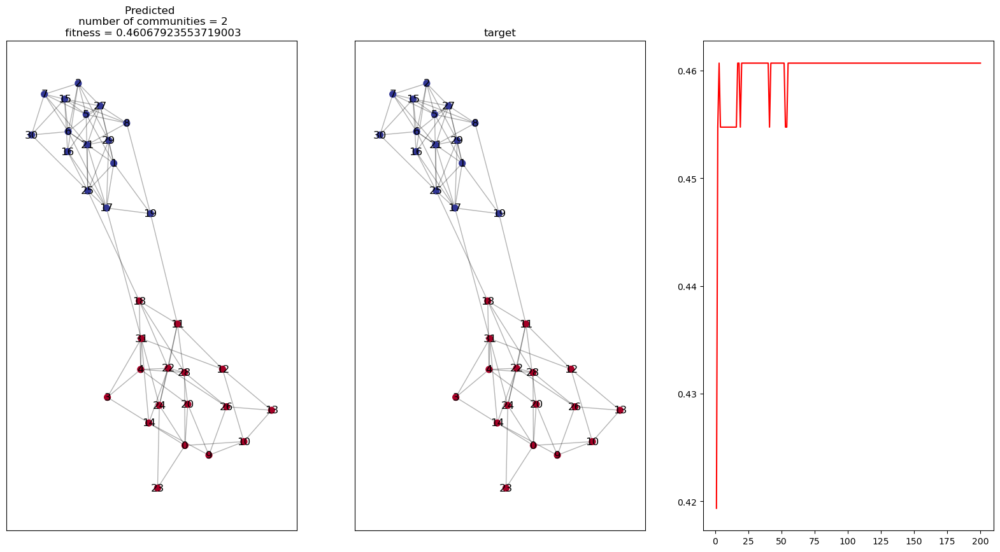

In [68]:
for network, labels in zip(networks, networksLabels):
    problParams = {'network': network, 'fitness': ModularityFitness(network)}
    ga = GA(gaParams, problParams)
    [best, fitnesses, medianFitness] = ga.solve()
    plotPredictedTargetNetworkAndFitness(problParams['network'], best.fitness, Chromosome.communityLabels(best.representation), fitnesses, medianFitness, gaParams['noGen'], greedyCommunitiesDetectionByTool(problParams['network']))


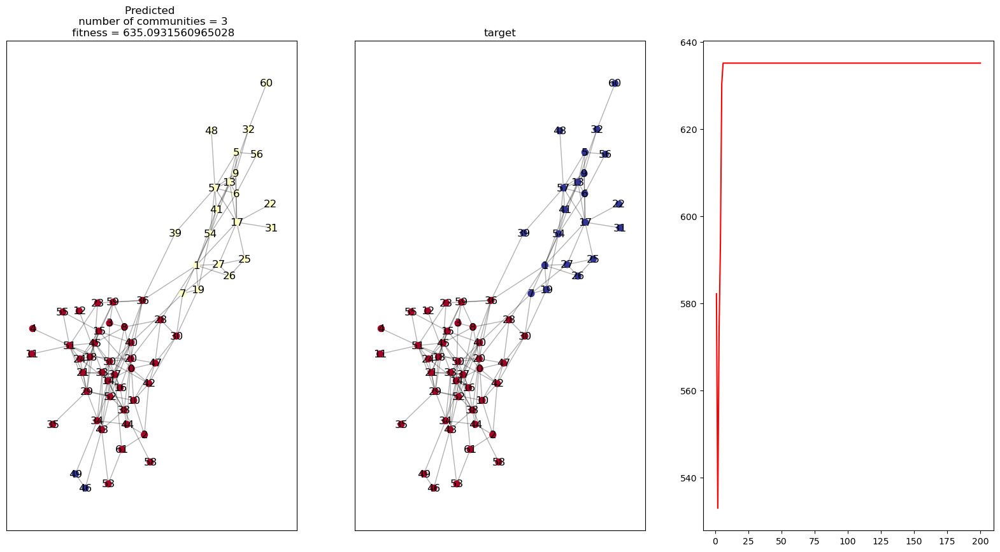

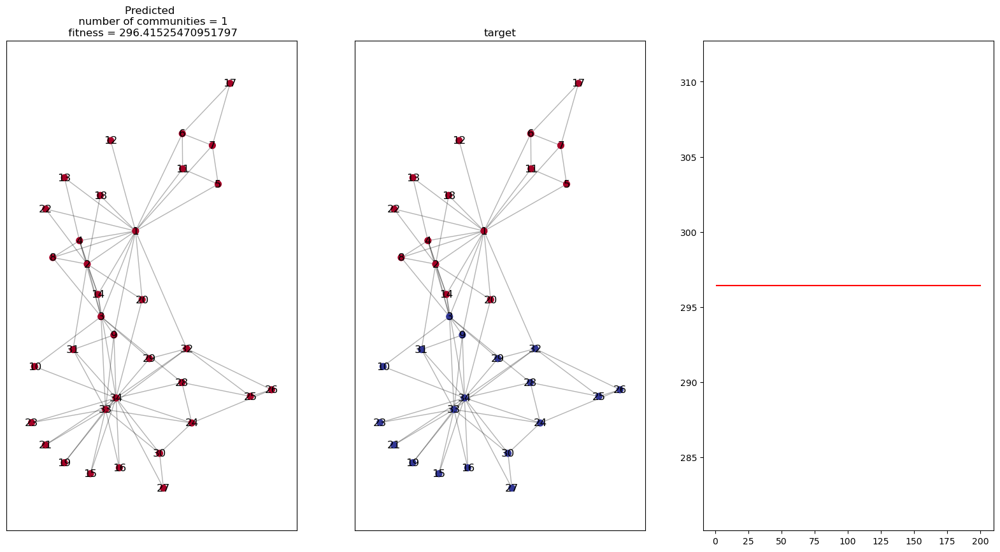

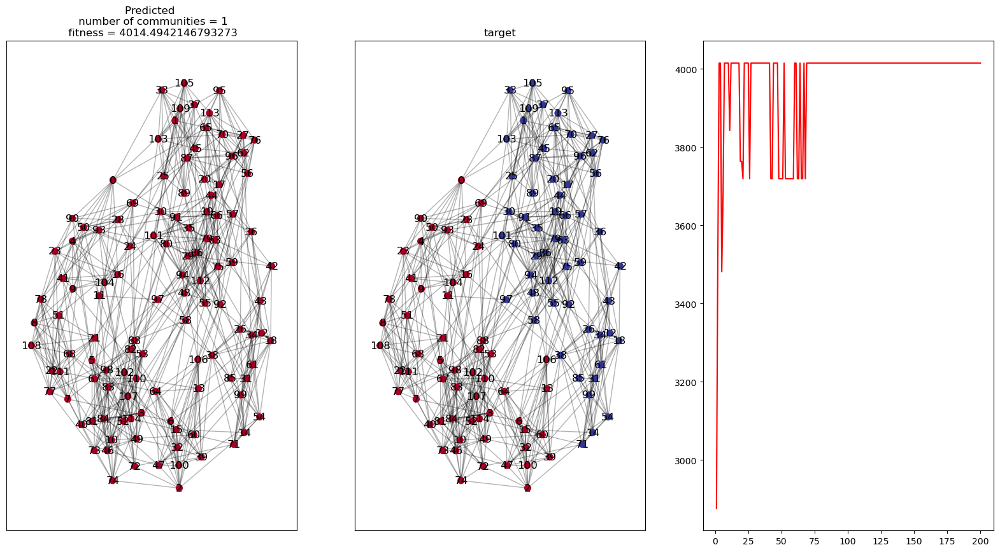

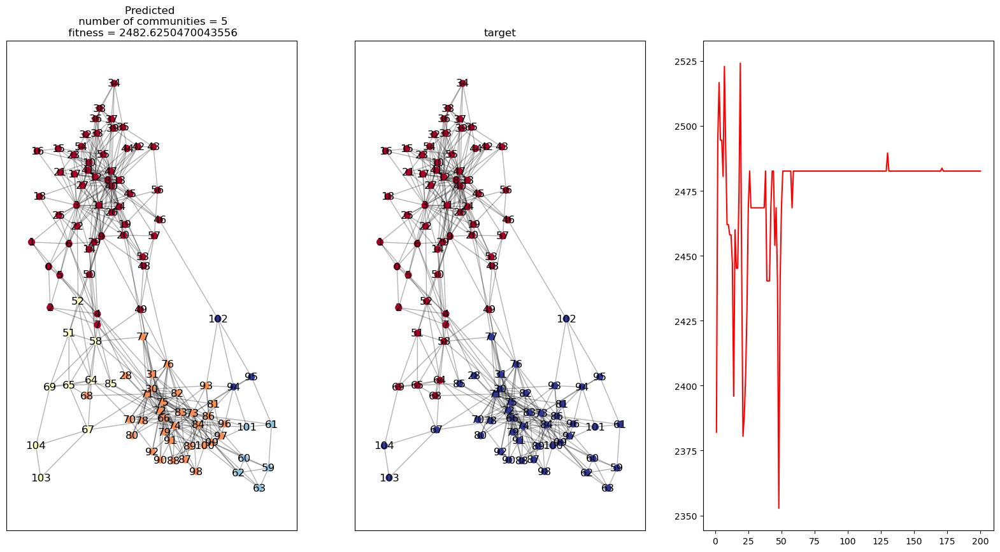

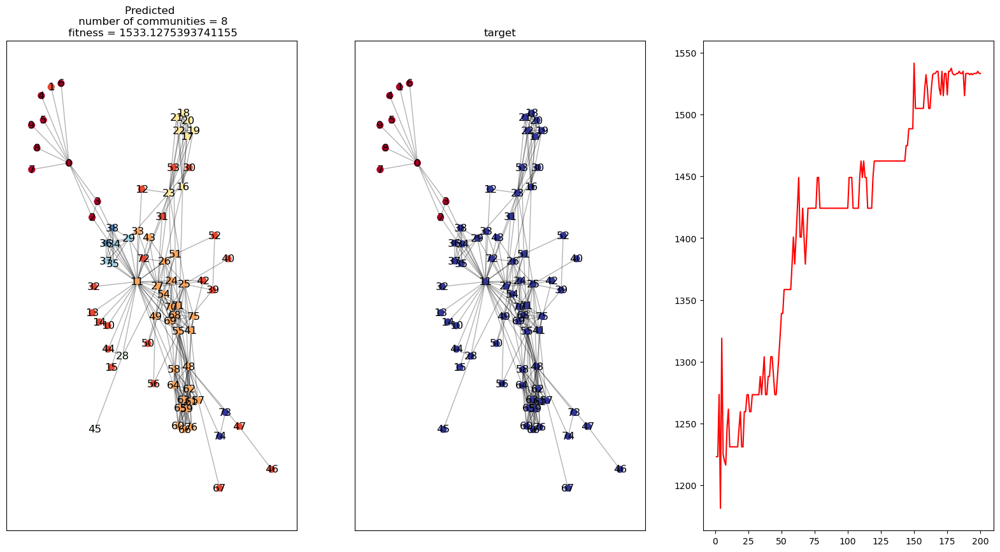

...

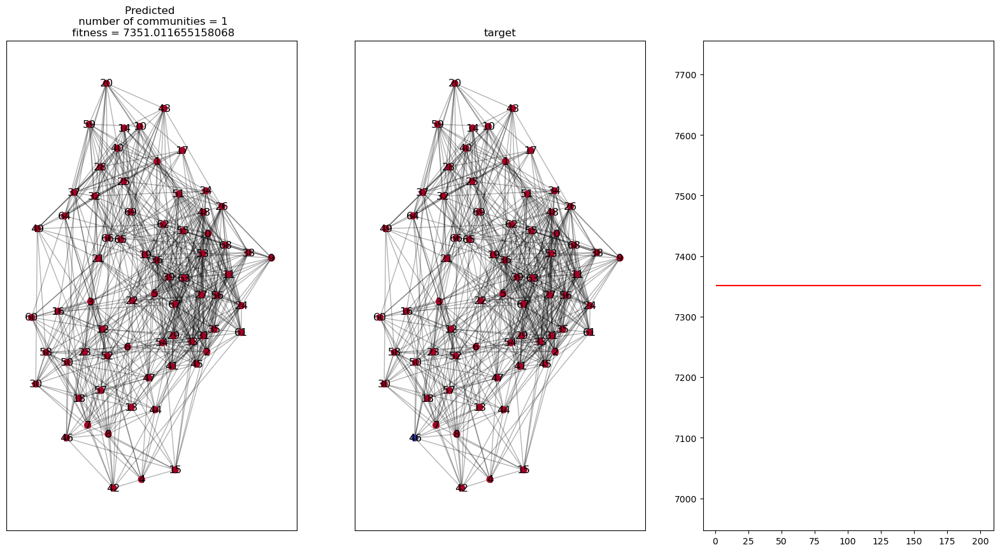

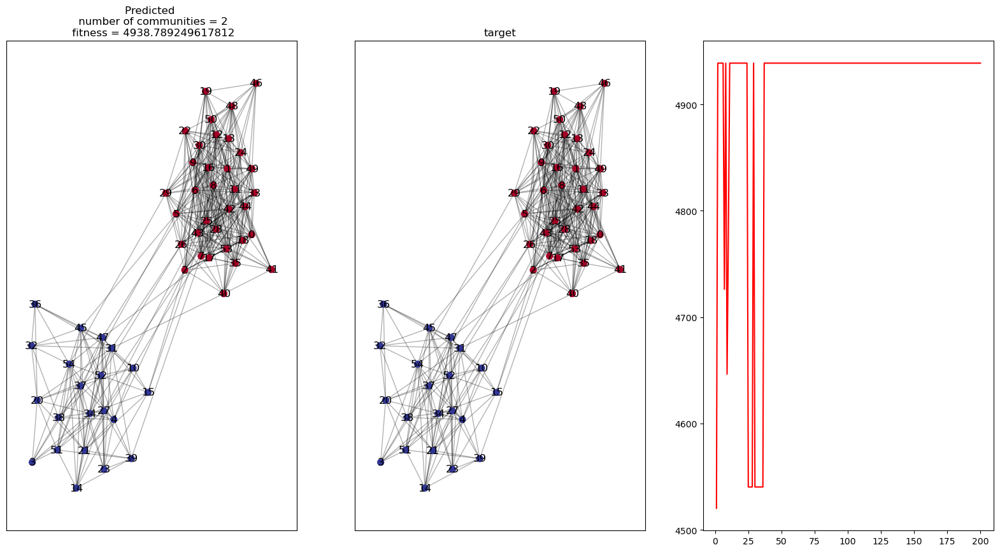

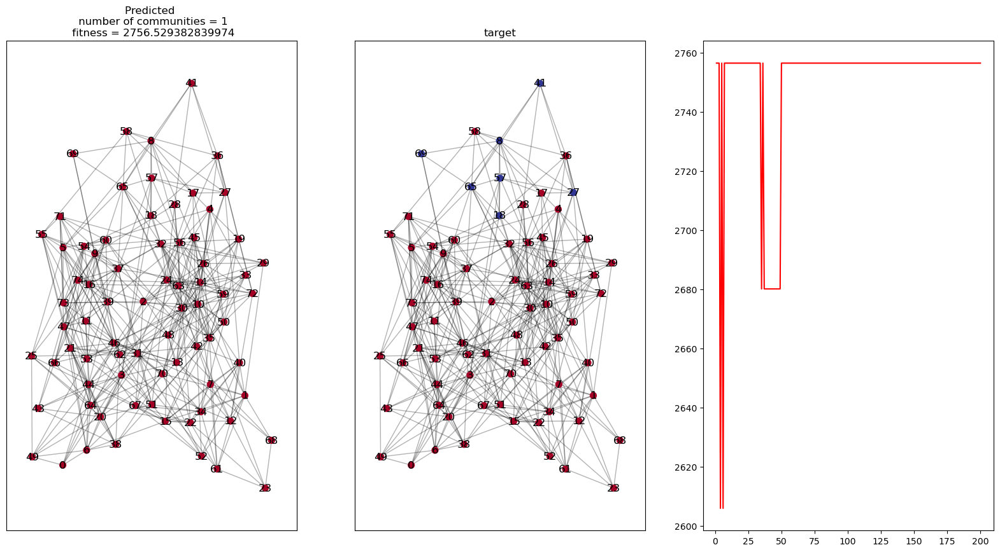

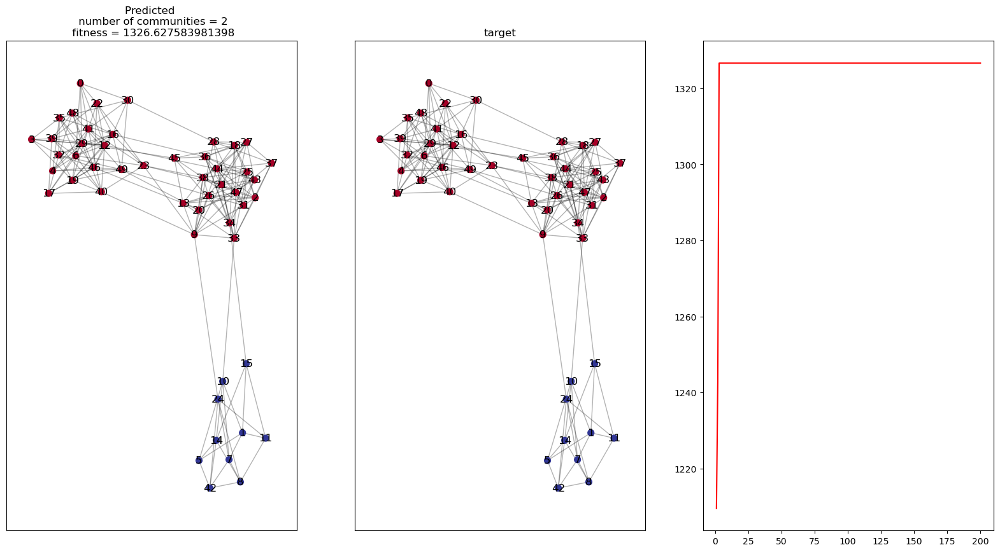

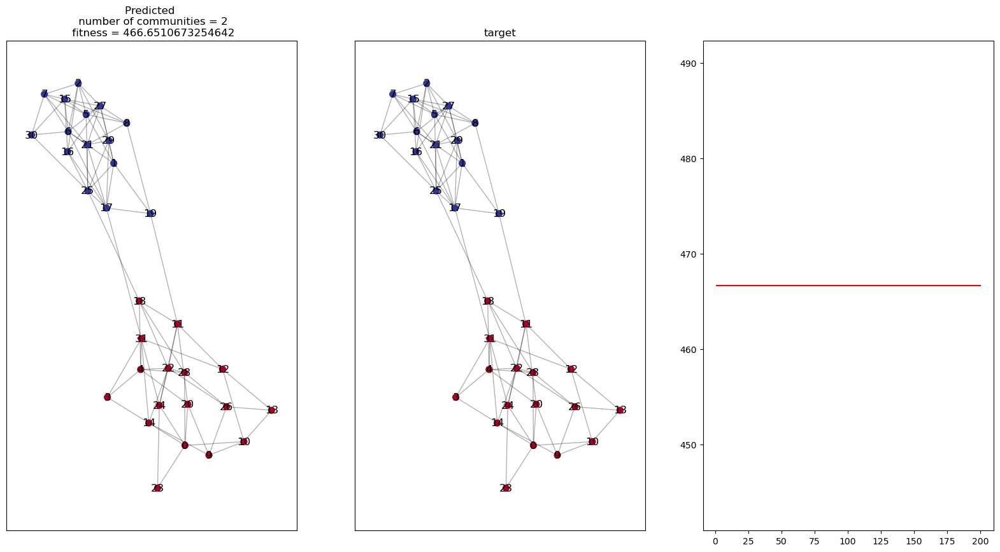

In [69]:
for network, labels in zip(networks, networksLabels):
    problParams = {'network': network, 'fitness': CommunityScoreFitness(network = network, alpha = 0.25)}
    ga = GA(gaParams, problParams)
    [best, fitnesses] = ga.solve()
    plotPredictedTargetNetworkAndFitness(problParams['network'], best.fitness, Chromosome.communityLabels(best.representation), fitnesses, gaParams['noGen'], greedyCommunitiesDetectionByTool(problParams['network']))


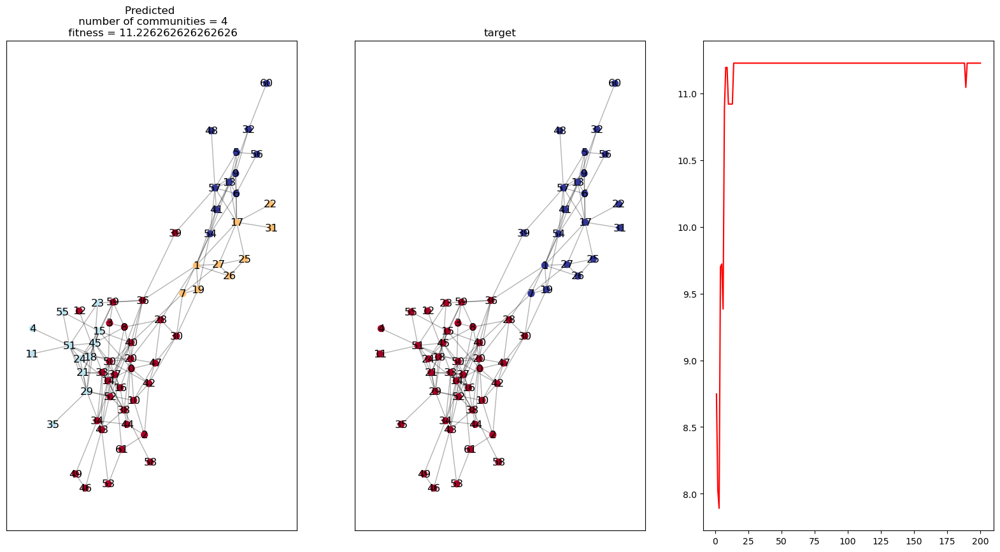

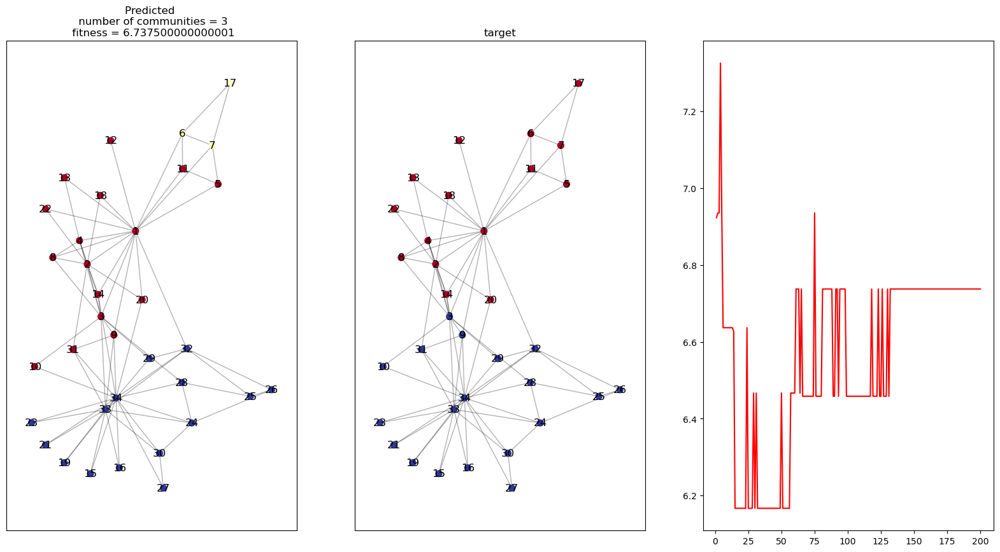

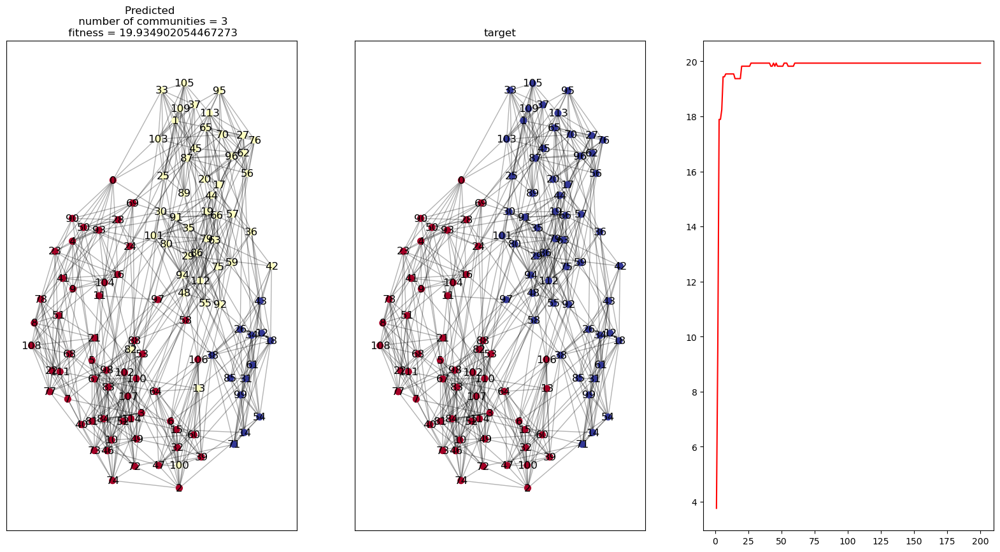

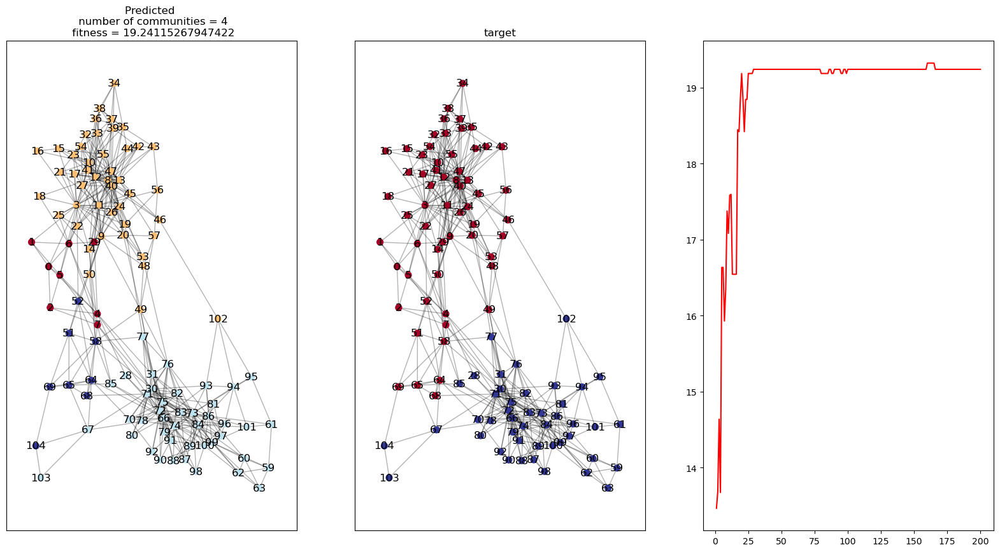

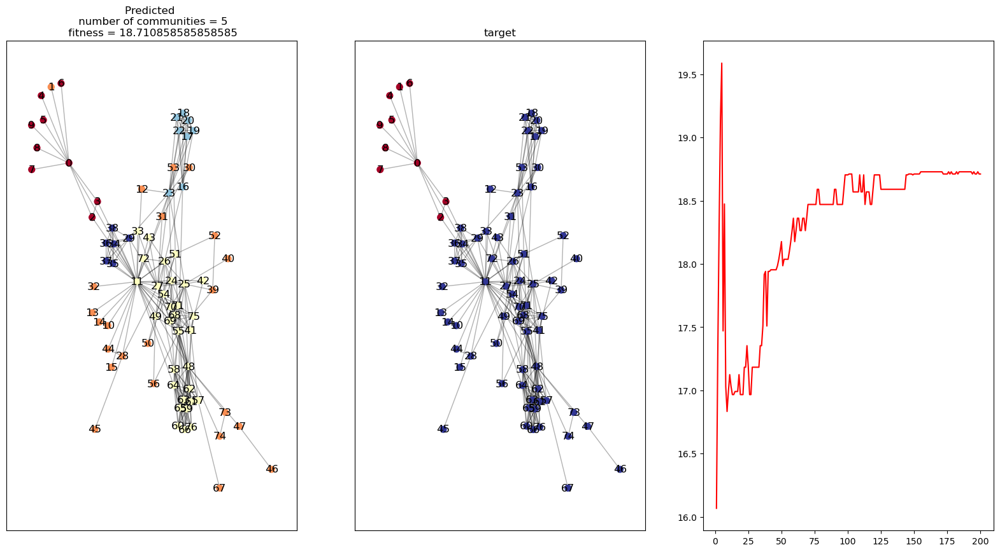

...

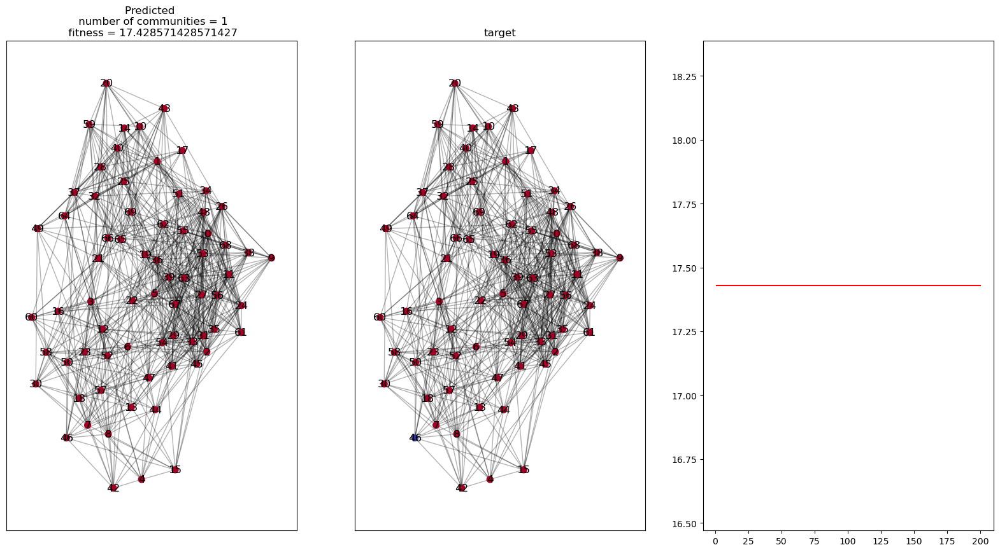

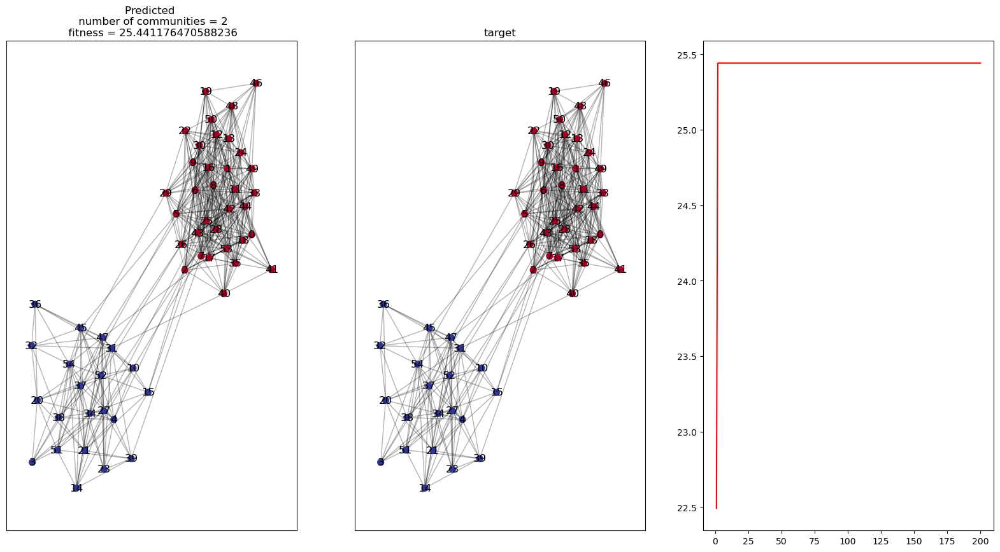

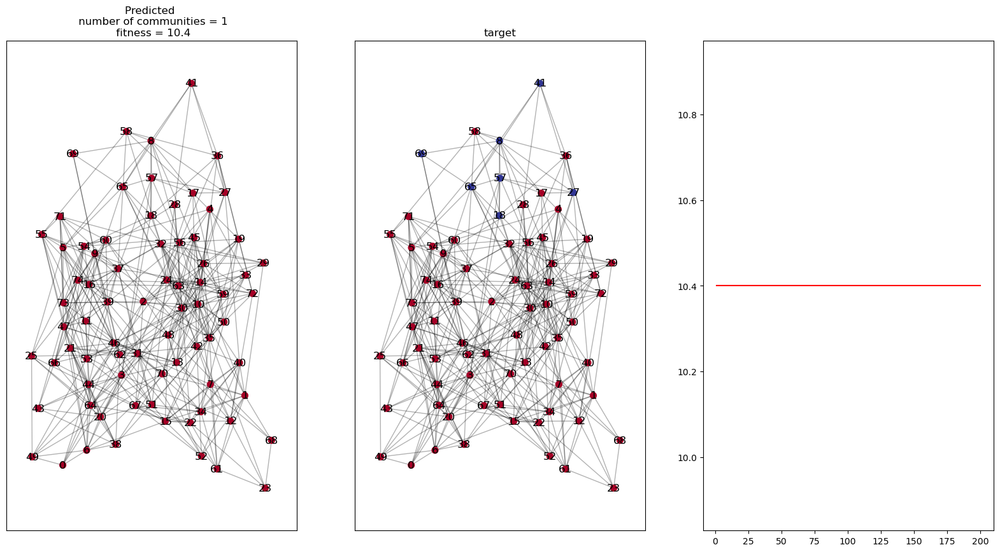

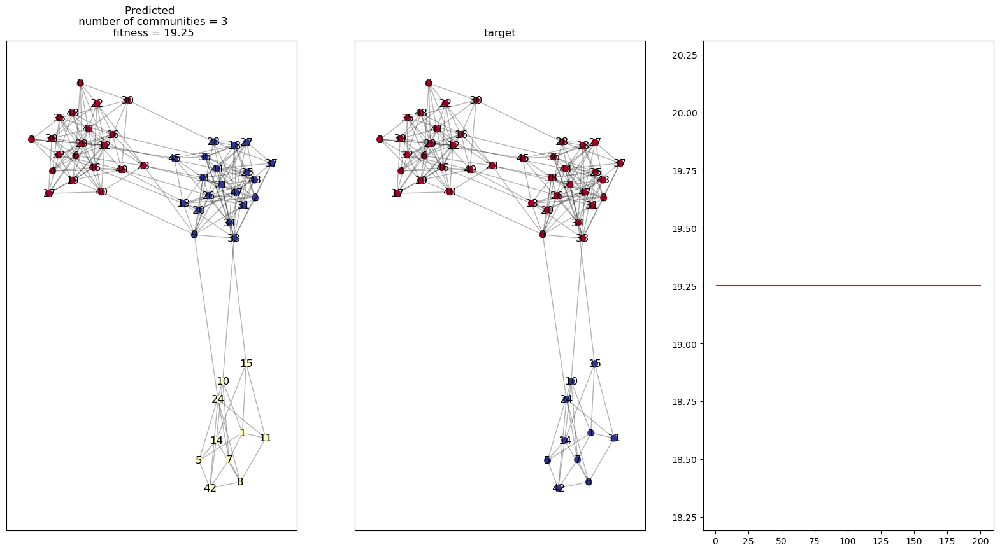

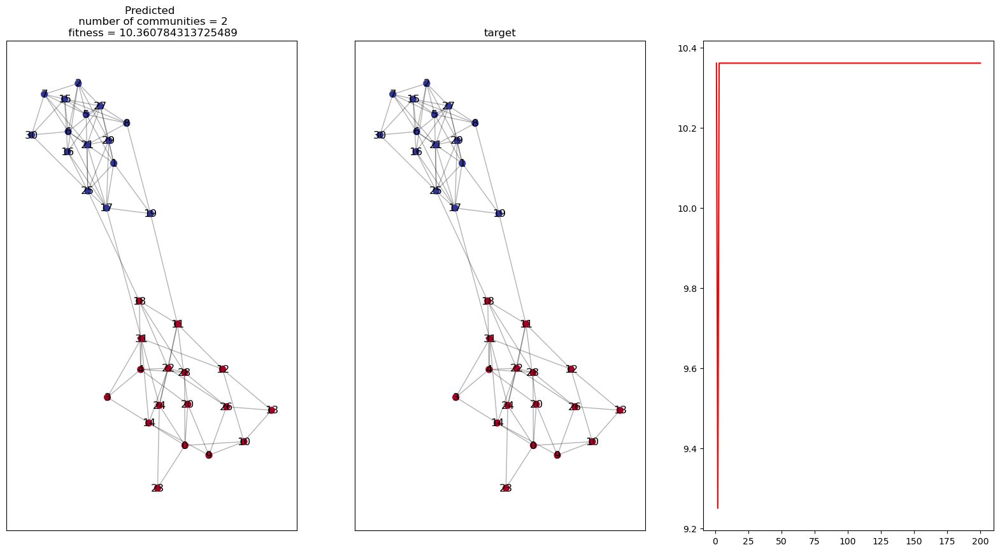

In [70]:
for network, labels in zip(networks, networksLabels):
    problParams = {'network': network, 'fitness': ModularityDensityFitness(network)}
    ga = GA(gaParams, problParams)
    [best, fitnesses] = ga.solve()
    plotPredictedTargetNetworkAndFitness(problParams['network'], best.fitness, Chromosome.communityLabels(best.representation), fitnesses, gaParams['noGen'], greedyCommunitiesDetectionByTool(problParams['network']))


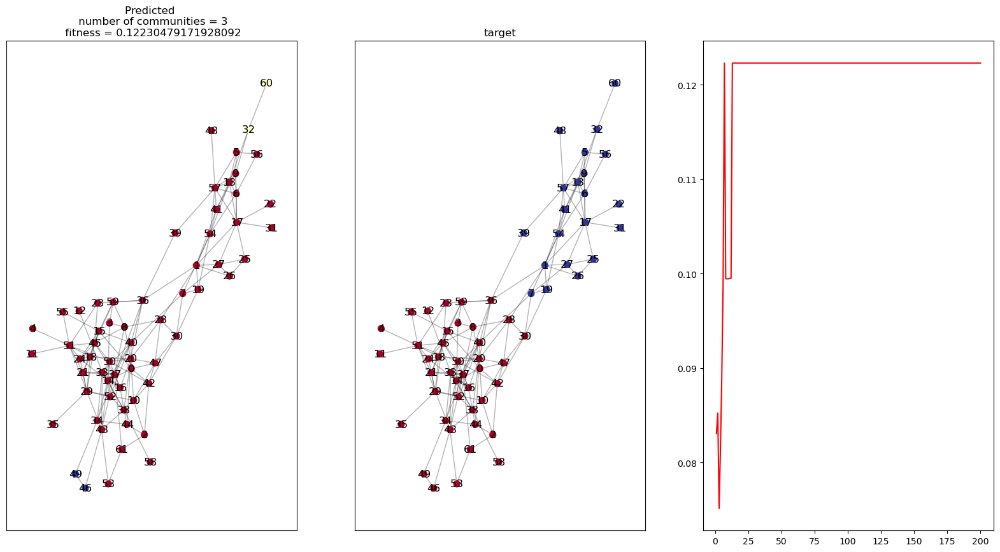

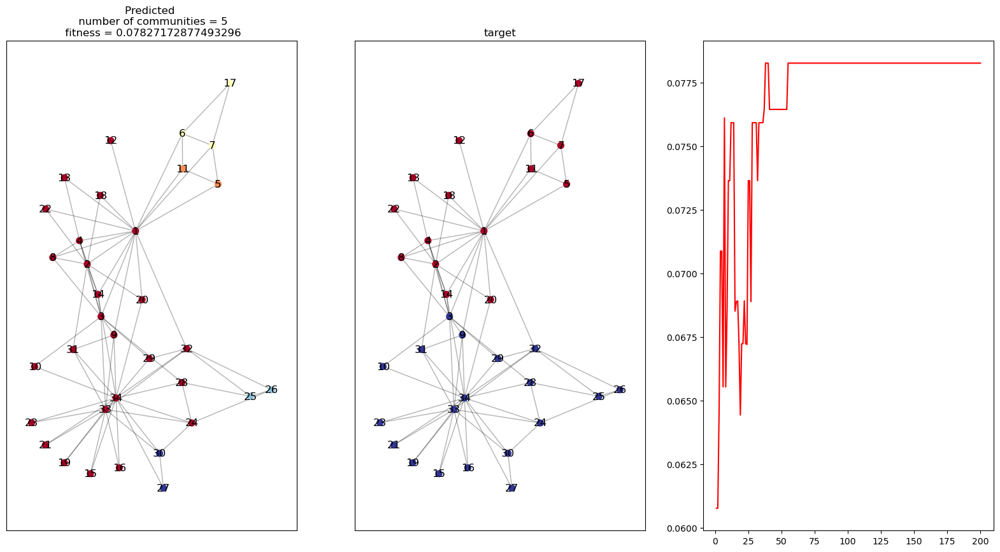

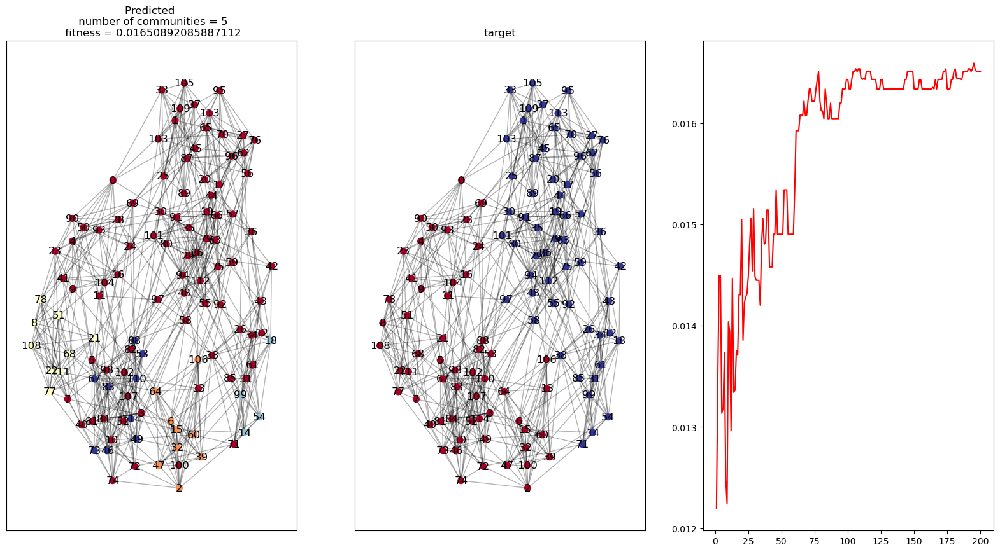

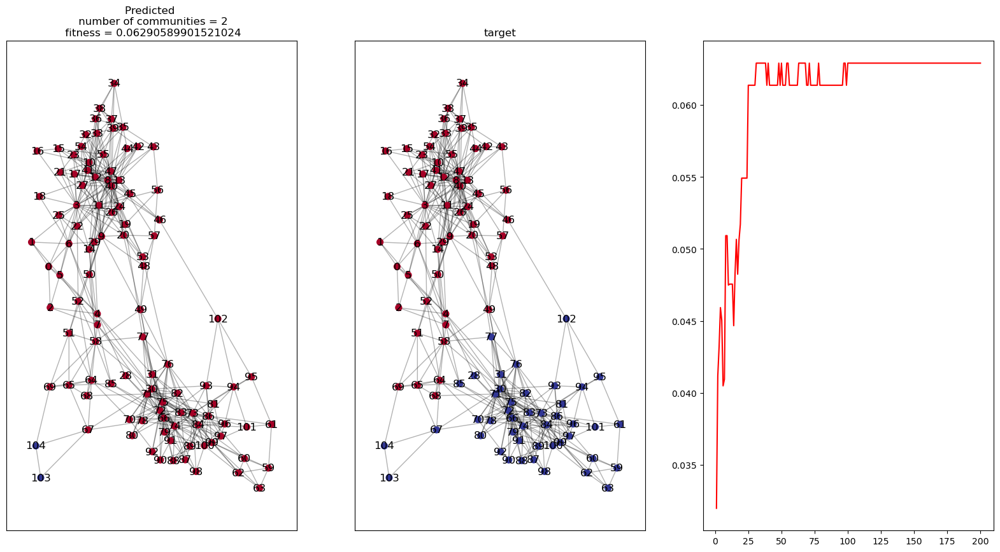

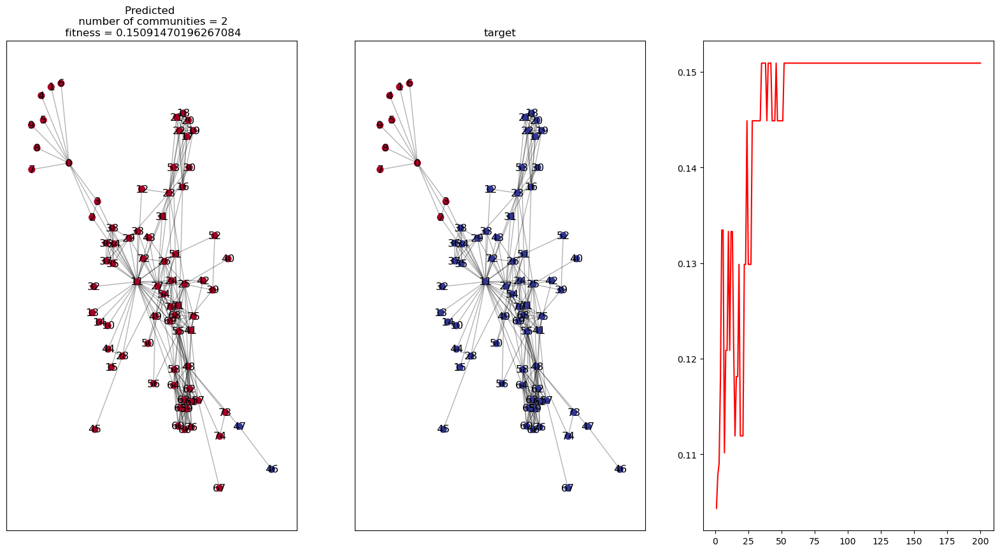

...

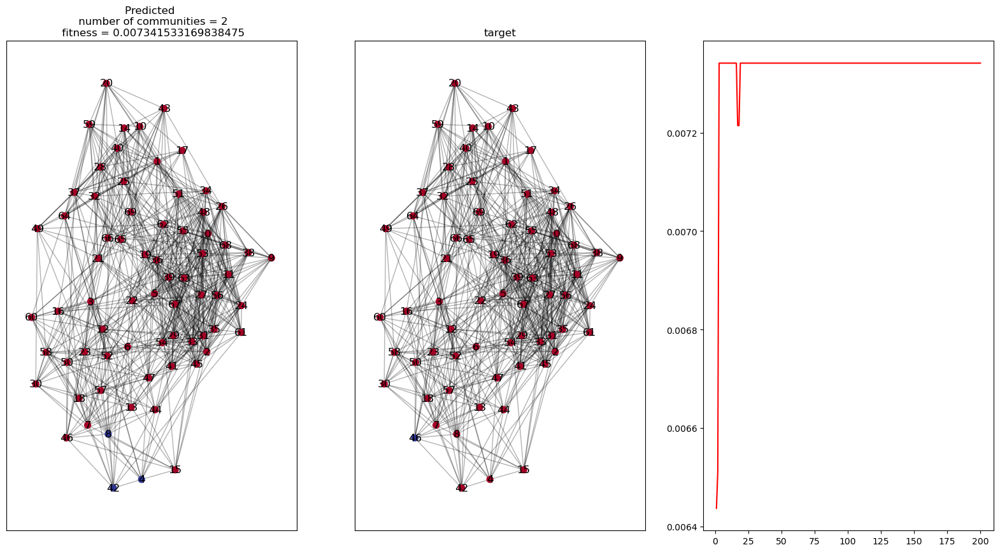

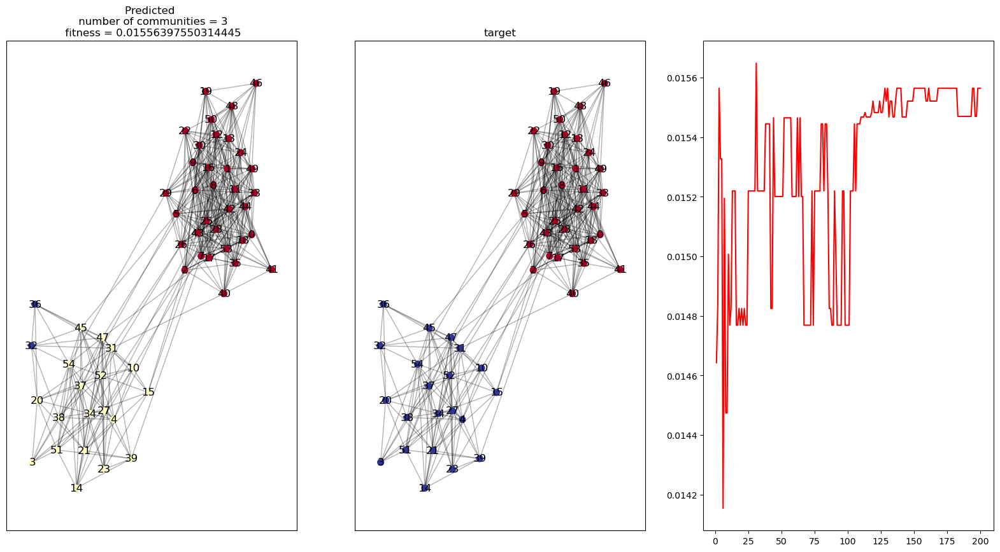

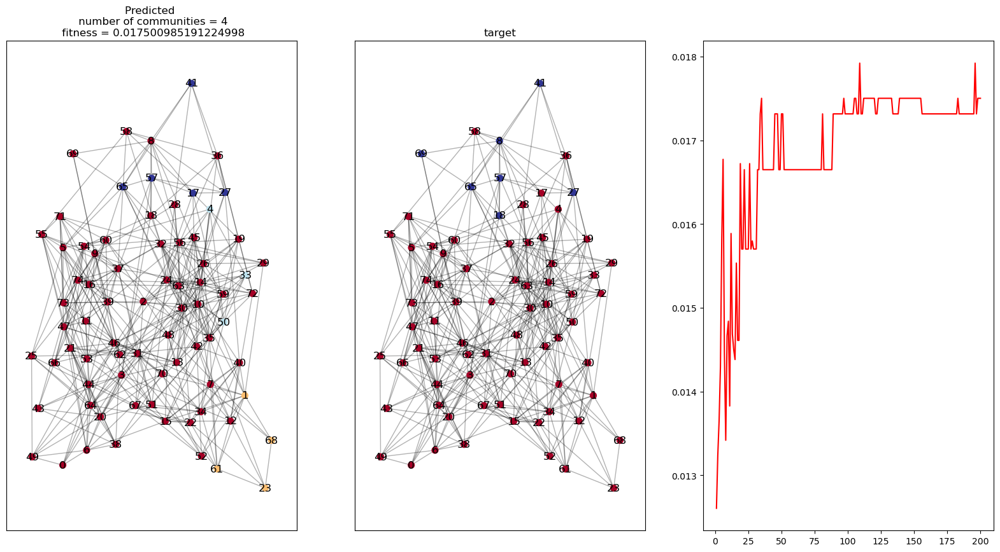

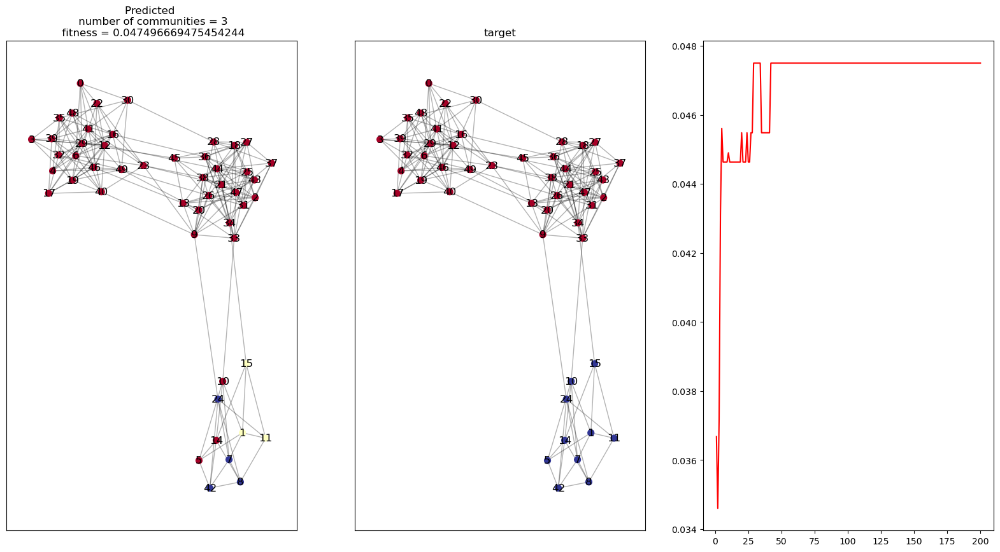

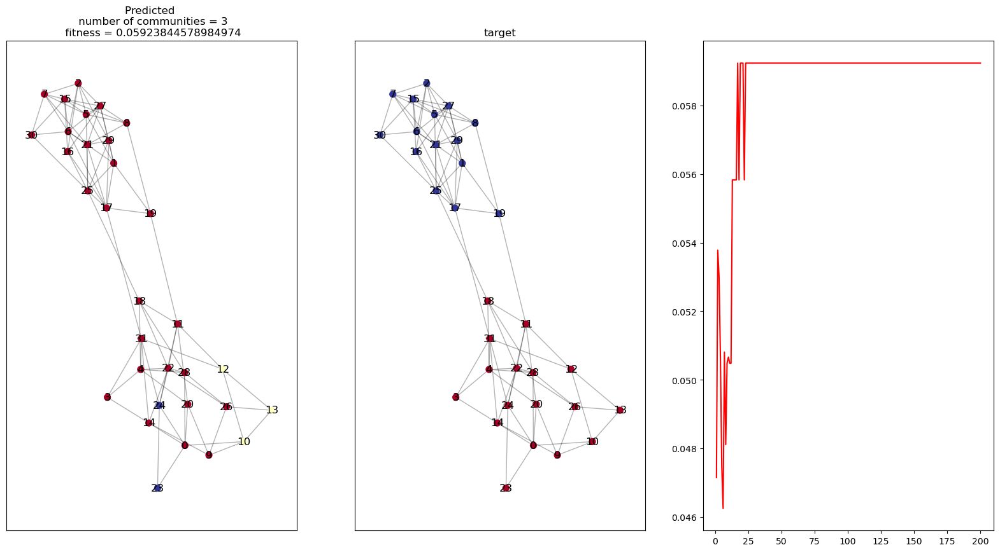

In [71]:
for network, labels in zip(networks, networksLabels):
    problParams = {'network': network, 'fitness': FitnessCommunityFitness(network = network, alpha = 1.75)}
    ga = GA(gaParams, problParams)
    [best, fitnesses] = ga.solve()
    plotPredictedTargetNetworkAndFitness(problParams['network'], best.fitness, Chromosome.communityLabels(best.representation), fitnesses, gaParams['noGen'], greedyCommunitiesDetectionByTool(problParams['network']))
